# Advanced Lane Finding  

The goal of this project is to use advanced computer vision techniques to find lanes on roads. 
* Camera Calibration 
* Distortion Correction 
* Thresholding an image
* Perspective Transformation
* Polynomial fitting on lane line pixels 
* Computing the radius of curvature and positions of the vehicle.
* Projecting back to road surface. 
* Pipeline Video


In [330]:
import numpy as np 
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob


In [331]:
def read_img(path):
    return cv2.imread(path)

In [332]:
def bgr2rgb(image):
    return cv2.cvtColor(image,cv2.COLOR_BGR2RGB)

In [333]:
def show_images(images, cmap = None, title = ''): #Display a list of images in a grid 
    cols = 3
    rows = (len(images)+1)/cols
    fig = plt.figure(figsize=(60,30))
    fig.suptitle(title, fontsize=100)
    for i, image in enumerate(images):
        image.shape
        plt.subplot(rows,cols,i+1)
        if len(image.shape) > 2:
            cmap = 'BrBG'
        else:
            cmap='gray'
        plt.imshow(image,cmap)
    plt.show()

In [334]:
def show_side_by_side(img1,img2, title1= "Image 1", title2 = "Image 2", cmap=('jet','jet')):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10), sharex=True, sharey=True)

    ax1.axis('off')
    ax1.imshow(img1,cmap = cmap[0])
    ax1.set_title(title1)
    ax1.set_adjustable('box-forced')


    ax2.axis('off')
    ax2.imshow(img2,cmap = cmap[1])
    ax2.set_title(title2)
    ax1.set_adjustable('box-forced')
    plt.show()
    #return fig

In [335]:
def undistort_img(img, camera_matrix,dist):
    h,  w = img.shape[:2]
    dst = cv2.undistort(img, mtx, dist,None)
    return(dst)
   

In [336]:
def undistort_img2(img, camera_matrix,dist):
    h,  w = img.shape[:2]
    newcameramtx, roi=cv2.getOptimalNewCameraMatrix(camera_matrix,dist,(w,h),1,(w,h))
    dst = cv2.undistort(img, camera_matrix, dist, None, newcameramtx)
    x,y,w,h = roi
    dst = dst[y:y+h, x:x+w]
    return(dst)

In [337]:
def corners_unwarp2(img, nx, ny, mtx, dist):
    # Pass in your image into this function
    image = img.copy()
    warped = np.copy(img)
    undist_img = undistort_img2(image, mtx,dist)
    gray = cv2.cvtColor(undist_img,cv2.COLOR_RGB2GRAY)
    ret,corners = cv2.findChessboardCorners(gray,(nx,ny),None)
    mat_perspective = None
    if ret == True:
        offset = 100 # offset for dst points
        img_size = (gray.shape[1], gray.shape[0])
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        mat_perspective = cv2.getPerspectiveTransform(src,dst)
        warped = cv2.warpPerspective(undist_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 
     
    return warped, mat_perspective

In [338]:
def corners_unwarp(img, nx, ny, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    unwarped = None
    M= None
    if ret == True:
        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        offset = 100
        img_size = (gray.shape[1], gray.shape[0])
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        M = cv2.getPerspectiveTransform(src, dst)
        unwarped = cv2.warpPerspective(undist, M, img_size)
    return unwarped, M

In [339]:
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output

In [340]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    
    sobel_x = cv2.Sobel(gray,cv2.CV_64F,1,0,ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray,cv2.CV_64F,0,1,ksize=sobel_kernel)
    
    mag = np.sqrt(sobel_x**2 + sobel_y**2)
    scale_factor = np.max(mag)/255
    mag_scaled = np.uint8(mag/scale_factor)
    
    binary_output = np.zeros_like(mag_scaled)
    binary_output[(mag_scaled>=mag_thresh[0]) & (mag_scaled<=mag_thresh[1])] =1
  
    return binary_output

In [341]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    gray = cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)
    
    sobel_x = cv2.Sobel(gray,cv2.CV_64F,1,0,ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray,cv2.CV_64F,0,1,ksize=sobel_kernel)
    
    abs_sobel_x = np.abs(sobel_x)
    abs_sobel_y = np.abs(sobel_y)
    angle = np.arctan2(abs_sobel_y, abs_sobel_x)
    
    binary_output = np.zeros_like(angle)
    binary_output[(angle>=thresh[0]) & (angle <= thresh[1])] = 1
    
    return binary_output

In [342]:
def hls_select(img, thresh=(0, 255)):
    image_hls = cv2.cvtColor(img,cv2.COLOR_BGR2HLS)
    _,_,s = cv2.split(image_hls)
    binary_output = np.zeros_like(s)
    binary_output[(s>=thresh[0]) & (s<=thresh[1])] =1
    return binary_output

In [343]:
def color_threshold(img,colorspace = 'HLS',channel = 2,thresh=(0, 255)):
    if(channel<0 | channel >2):
        return -1
    
    binary_output = np.zeros_like(img[:,:,0])
    if(colorspace == 'HLS'):
        image_colorspace = cv2.cvtColor(img,cv2.COLOR_BGR2HLS)
    elif(colorspace == 'Lab'):
        image_colorspace = cv2.cvtColor(img,cv2.COLOR_BGR2Lab)
    elif(colorspace == 'HSV'):
        image_colorspace = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)
    elif(colorspace == 'LUV'):
        image_colorspace = cv2.cvtColor(img,cv2.COLOR_BGR2LUV)
    else:
        return -1
    
    image_channel = image_colorspace[:,:,channel]
    binary_output[(image_channel>=thresh[0]) & (image_channel<=thresh[1])] =1
        
    return binary_output

In [344]:
def threshold_pipeline(img):
    img = np.copy(img)
   
    #thresholded_yellow = color_threshold(img,colorspace = 'HSV',channel = 0,thresh=(20, 30))
    thresholded_yellow = color_threshold(img,colorspace = 'Lab',channel = 2,thresh=(140, 200))

    thresholded_white = color_threshold(img,colorspace = 'LUV',channel = 0,thresh=(210, 255))

    combined_binary = np.zeros_like(img[:,:,0])
    combined_binary[(thresholded_yellow == 1) | (thresholded_white == 1)] = 1

    
    return combined_binary

In [345]:
def get_radius_of_curvatrure(y_eval,x_coords,y_coords,meters_per_pixel_x = 3.7/700,meters_per_pixel_y = 30/720):
   
    # Fit new polynomials to x,y in world space
    fit_cr = np.polyfit(y_coords*meters_per_pixel_y, x_coords*meters_per_pixel_x, 2)
    
    # Calculate the new radii of curvature
    curverad = ((1 + (2*fit_cr[0]*y_eval*meters_per_pixel_y + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])
    return (curverad)
    
    

## Step1:  Camera Calibration 
The images from the camera have two kinds of transformations which needs to be corrected before we can accurately measure distances using the images.
1. Lens Distortion: Straight lines appear curved. There are two kinds of distortion radial and tangential. In case of radial distortion, the edges of the image appear distorted such that lines or objects appear more of less curved than they actually are. In case of tangential distortion the images look tilten so that some objects are appear father away or closer  than they actually are. 
2. Perspective Projection :Straght lines are preserved but angles are not preserved. Objects appear larger close to the camera, while distant objects appear small. 



### Removing Lens Distortion: 
The lens disortion can be removed by computing the distortion coefficients for radial and tangential distortion and camera matrix and then computing the corrected images. OpenCV  has  `findChessboardCorners` and `calibrateCamera` functions that are useful in getting the camera matrix. To obtain a camera matrix we need a mapping of the distorted image coordinates `imgpoints = []` and  `objpoints = []`. The chess board provides an easy way to get this mapping as the true coordinates can be easily obtained. 

Below are a sample of images of a chessboard pattern taken using the camera used to record the dash cam video. 

In [346]:
cal_images = [read_img(path) for path in glob.glob("../data/camera_cal/**.jpg")]

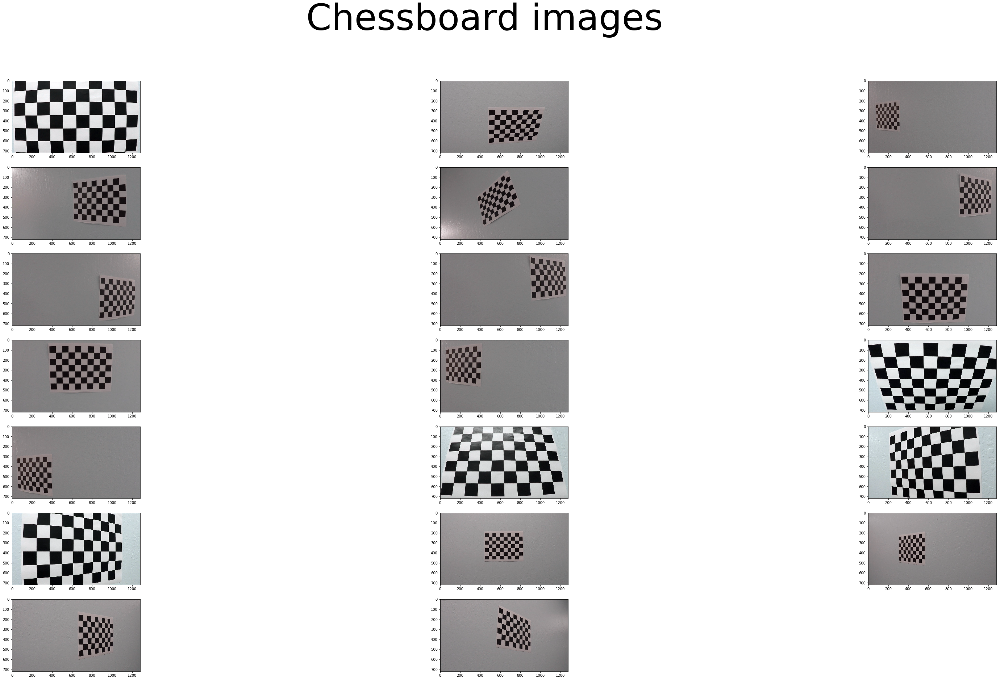

In [347]:
show_images(cal_images, title = "Chessboard images")

In [348]:

objpoints = []
imgpoints = []

objp = np.zeros(((6*9),3),np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

for image in cal_images:
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    ret,corners = cv2.findChessboardCorners(gray,(9,6),None)
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)


The corners are drawn using OpenCV's `drawChessboardCorners` function which requires the chessboard size and the corners as input.

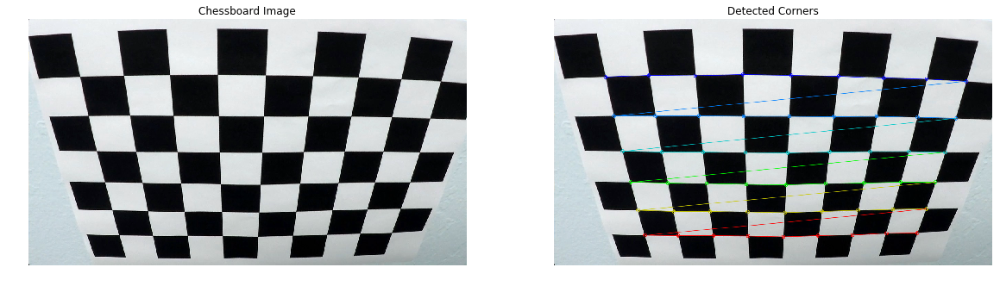

In [349]:
test_img = np.copy(cal_images[11])


gray = cv2.cvtColor(test_img,cv2.COLOR_BGR2GRAY)
ret,corners = cv2.findChessboardCorners(gray,(9,6),None)
drawn_img = cv2.drawChessboardCorners(test_img, (9,6), corners, ret)
if ret == True:
    imgpoints.append(corners)
    objpoints.append(objp)

show_side_by_side(cal_images[11],drawn_img, title1 = "Chessboard Image",title2 ="Detected Corners")


The mapping between `imgpoints = []` and `objpoints = []` is obtained using the `calibrateCamera` functions. Once we have the camera matrix and the distortion coefficients, the image can be undistorted using `undistort` function. Here are some exampels of applying the `undistort` function on the calibration images. You can notices the lines are long the edges are straighter. `undistort_img` function implements this functionality.

In [350]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)

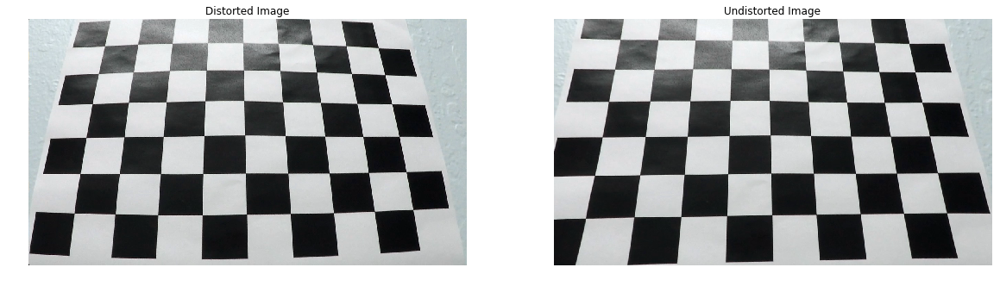

In [351]:

img = np.copy(cal_images[13])
h,  w = img.shape[:2]
dst = cv2.undistort(img, mtx, dist,None)
show_side_by_side(img,dst, title1 = "Distorted Image",title2 ="Undistorted Image")

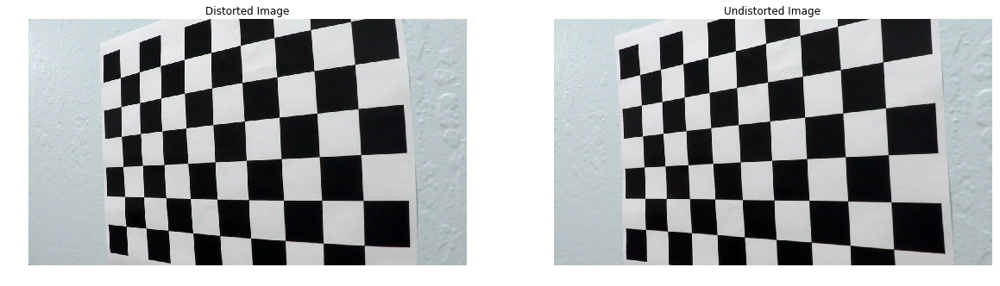

In [352]:
img = np.copy(cal_images[14])
dst = undistort_img(img, mtx,dist)
show_side_by_side(img,dst, title1 = "Distorted Image",title2 ="Undistorted Image")

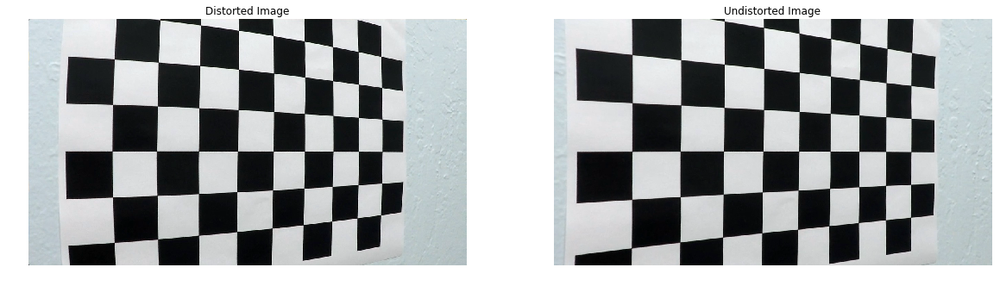

In [353]:
img = np.copy(cal_images[15])
dst = undistort_img(img, mtx,dist)
show_side_by_side(img,dst, title1 = "Distorted Image",title2 ="Undistorted Image")

### Perspective distortion 

Removing perspective distortion involved mapping the points from the undistorted image from the previous step to true coordinates. The OpenCv function `getPerspectiveTransform` is used to map a set of points `src` to `dst`. The `src` points are chosen from the undistorted image and `dst` points are the same points without the perspective distortion. In our case we map the four corners of the chessboard to a rectangle. This step is implemented in `corners_unwarp(img, nx, ny, mtx, dist)` function.

In [354]:
nx = 9
ny = 6 
img = cal_images[11].copy()


undist_img = undistort_img2(img, mtx,dist)
gray = cv2.cvtColor(undist_img,cv2.COLOR_RGB2GRAY)
ret,corners = cv2.findChessboardCorners(gray,(nx,ny),None)
#img_with_corners = np.copy(dst)
#if ret == True:
gg = cv2.drawChessboardCorners(gray,(nx,ny),corners,ret)
    
    
    
    



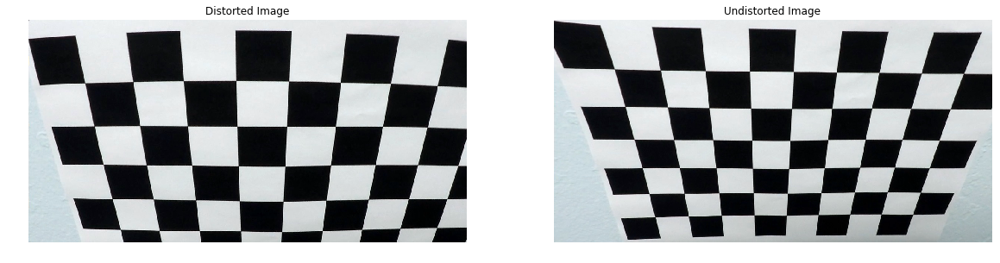

In [355]:
show_side_by_side(img,undist_img, title1 = "Distorted Image",title2 ="Undistorted Image")


In [356]:
cc = np.array(corners)

In [357]:
cc.shape

(54, 1, 2)

In [358]:
def indx(row, col, nx):
    return (col)+(nx*row)


In [359]:
nx = 9
src = np.float32([cc[indx(0,0,nx)],cc[indx(0,8,nx)],cc[indx(5,8,nx)],cc[indx(5,0,nx)]])
dst = np.float32([[100,100],[400,100],[400,400],[100,400]])

In [360]:
gray.shape

(593, 1166)

In [361]:
mat_perspective = cv2.getPerspectiveTransform(src,dst)

In [362]:
#unwarped_img = np.zeros_like(undist_img)
unwarped_img = cv2.warpPerspective(undist_img,mat_perspective,dsize=(500,500),flags=cv2.INTER_LINEAR) 

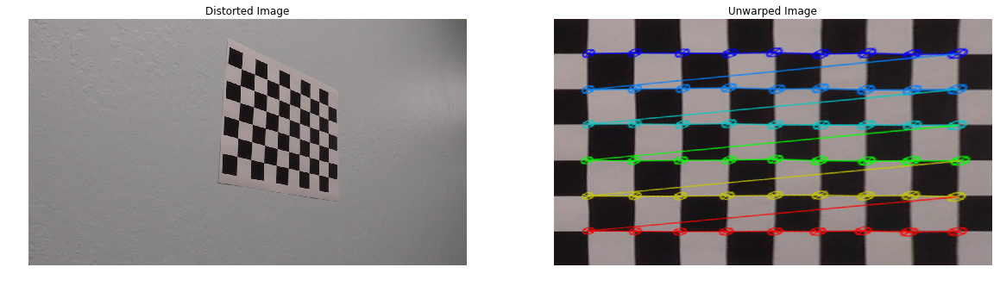

In [363]:
nx = 9
ny = 6 
img = cal_images[19].copy()
undist_img = undistort_img(img, mtx,dist)
unwarped, M = corners_unwarp(img, nx, ny, mtx, dist)
show_side_by_side(img,unwarped, title1 = "Distorted Image",title2 ="Unwarped Image")

### Apply a perspective transform to rectify binary image ("birds-eye view").
We can remove the perspective distortion from the road images by choosing the `src` and `dst` points in a similar fashion and computing the perspective transformation matrix. The transformation matrix can then be applied to all the images to obtain the bird's eye view. 

In [364]:
test_images = [read_img(path) for path in glob.glob("../data/test_images/**.jpg")]
test_images_rgb = [bgr2rgb(image) for image in test_images]


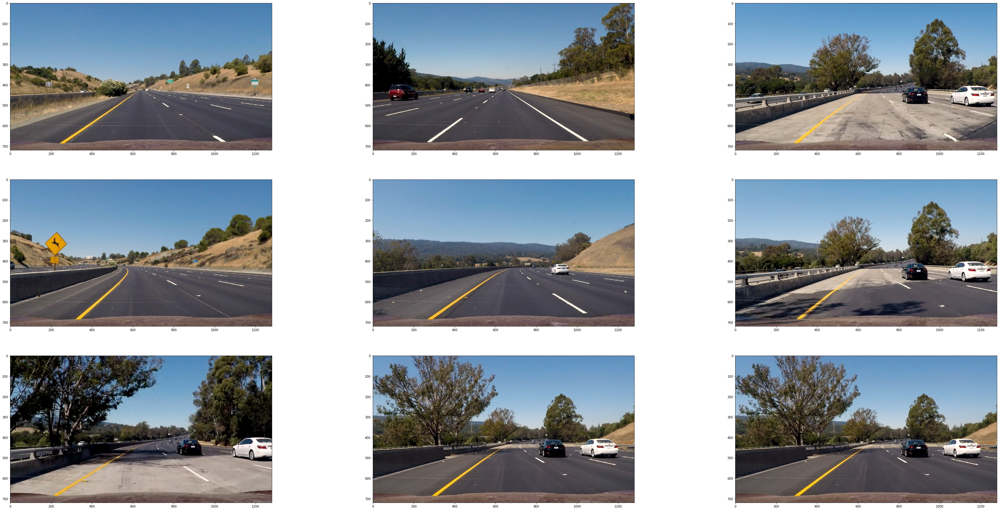

In [365]:
show_images(test_images_rgb)

Bird's eye view of the images above. 

In [366]:
undistorted_images = [undistort_img(image, mtx,dist) for image in test_images]
unwarped_images = [cv2.warpPerspective(image,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) for image in  undistorted_images]
unwarped_images_rgb = [bgr2rgb(image) for image in unwarped_images]



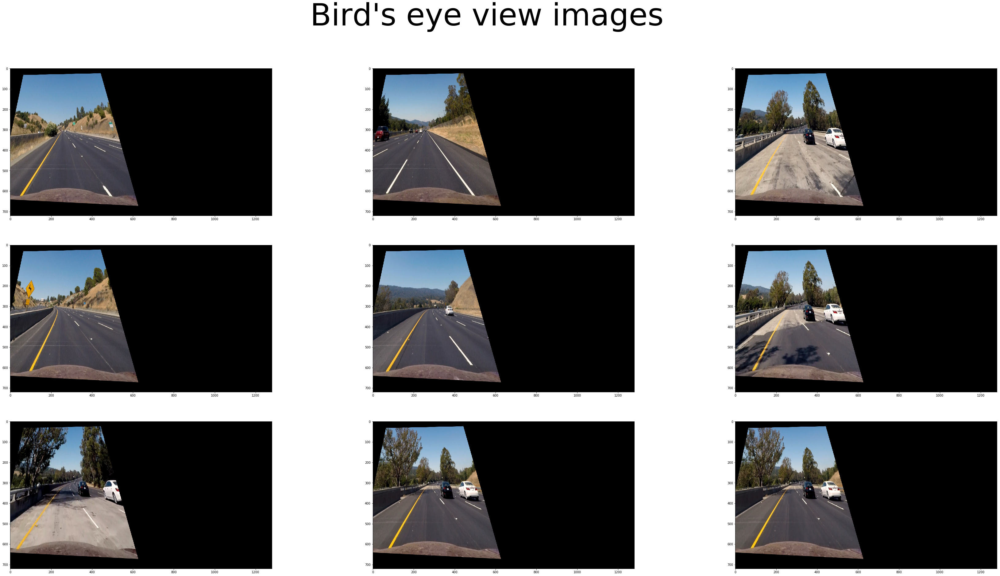

In [367]:
show_images(unwarped_images_rgb, title = "Bird's eye view images")

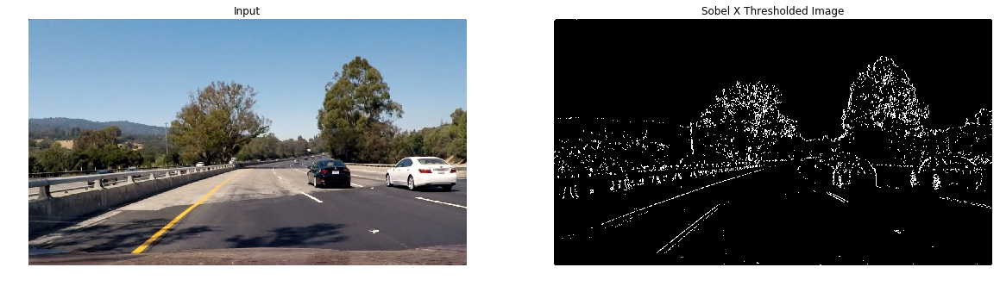

In [368]:
image_curved_lines_2 = cv2.imread("../data/test_images/test6.jpg")
undist_road_img = undistort_img(image_curved_lines_2, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 
show_side_by_side(rgb_img,sobel_x, title1= "Input", title2 = "Sobel X Thresholded Image",cmap=('jet','gray'))


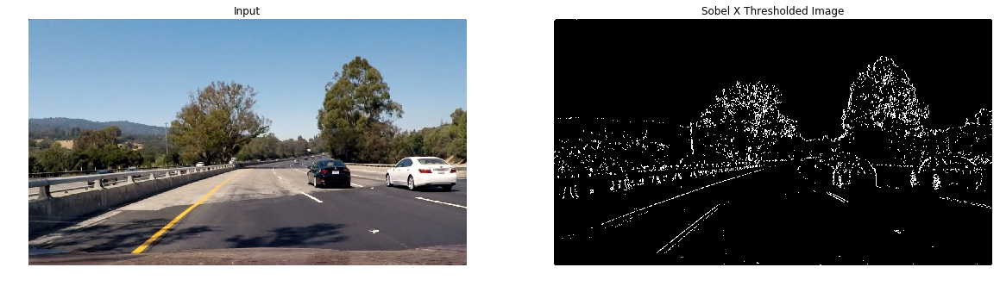

In [369]:
image = cv2.imread("../data/test_images/test4.jpg")
rgb_img = bgr2rgb(image)
sobel_x = abs_sobel_thresh(image, orient='x', thresh_min=30, thresh_max=150)
show_side_by_side(rgb_img,sobel_x, title1= "Input", title2 = "Sobel X Thresholded Image",cmap=('jet','gray'))


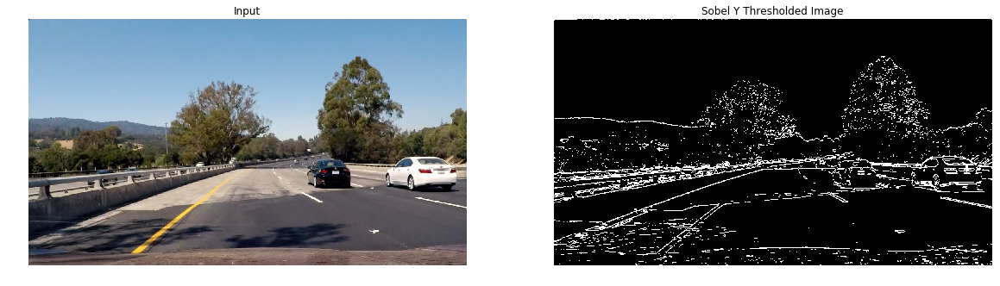

In [370]:
sobel_y = abs_sobel_thresh(image, orient='y', thresh_min=30, thresh_max=250)
show_side_by_side(rgb_img,sobel_y, title1= "Input", title2 = "Sobel Y Thresholded Image",cmap=('jet','gray'))


In [371]:
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

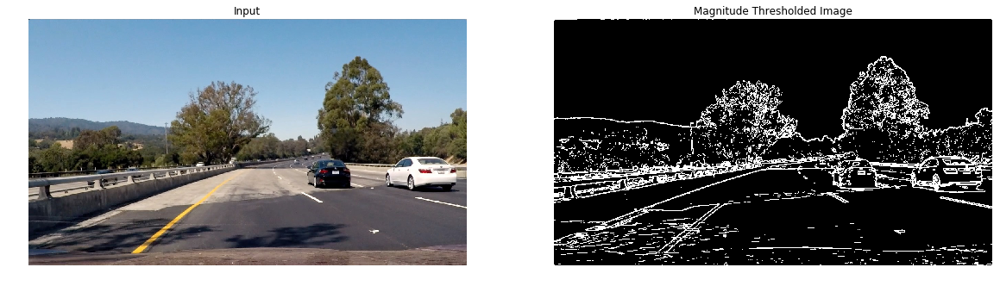

In [372]:
mag_threshold_img = mag_thresh(image, sobel_kernel=5, mag_thresh=(30, 255))
show_side_by_side(rgb_img,mag_threshold_img, title1= "Input", title2 = "Magnitude Thresholded Image",cmap=('jet','gray'))


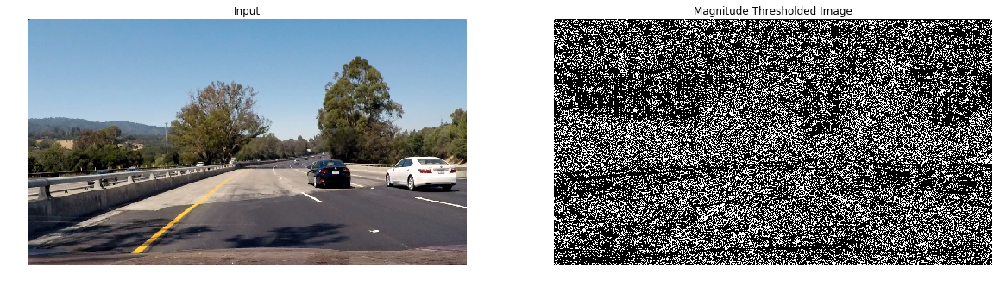

In [373]:
dir_threshold_img = dir_threshold(image, sobel_kernel=3, thresh=(0.6,1.2))
show_side_by_side(rgb_img,dir_threshold_img, title1= "Input", title2 = "Magnitude Thresholded Image",cmap=('jet','gray'))


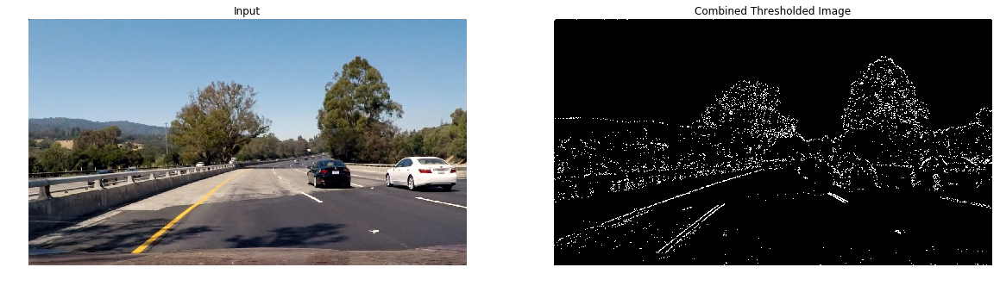

In [374]:



combined = np.zeros_like(dir_threshold_img)
combined[((sobel_x == 1) & (sobel_y == 1)) | ((mag_threshold_img == 1) & (dir_threshold_img == 1)  )] = 1

show_side_by_side(rgb_img,combined, title1= "Input", title2 = "Combined Thresholded Image",cmap=('jet','gray'))


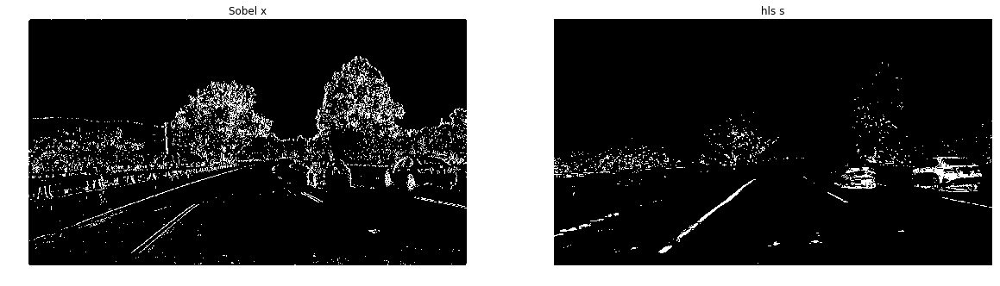

In [375]:
sobel_x_threshold = abs_sobel_thresh(image, orient='x', thresh_min=20, thresh_max=190)
hls_s_threshold = hls_select(image, thresh=(170, 255))
show_side_by_side(sobel_x_threshold,hls_s_threshold, title1= "Sobel x", title2 = " hls s ",cmap=('gray','gray'))


Apply perspective transform to road image.

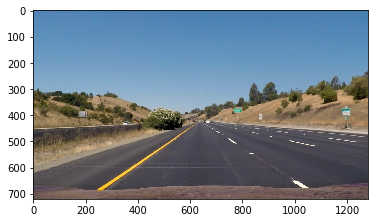

In [376]:
image_straight_lines = cv2.imread("../data/test_images/straight_lines1.jpg")
rgb_image_straight_lines = bgr2rgb(image_straight_lines)
plt.imshow(rgb_image_straight_lines)
plt.show()

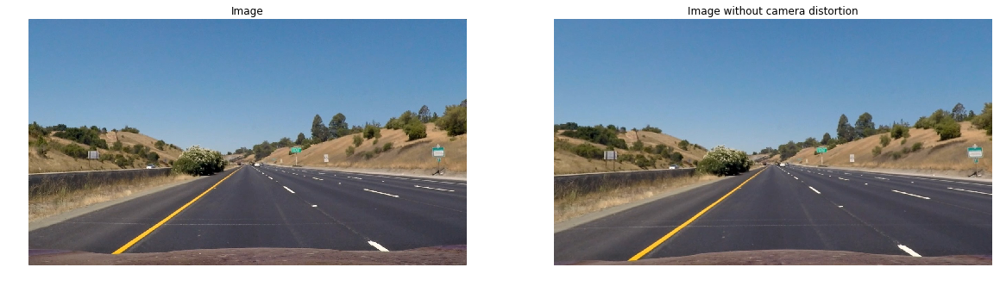

True

In [377]:
# removing distortion 

undist_road_img = undistort_img(image_straight_lines, mtx,dist)
show_side_by_side(bgr2rgb(image_straight_lines),bgr2rgb(undist_road_img), title1= "Image", title2 = "Image without camera distortion",cmap=('jet','jet'))
cv2.imwrite('../data/undistorted.png',undist_road_img)

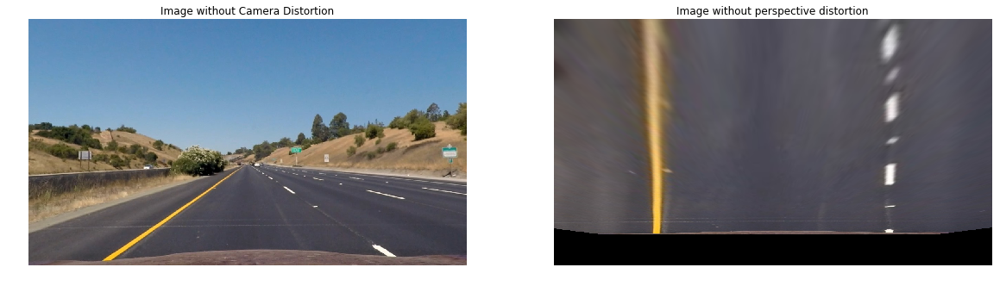

In [378]:
# compute the perspective transform 
offset_y = 100
offset_x = 300
gray = cv2.cvtColor(undist_road_img,cv2.COLOR_BGR2GRAY)
img_size = (gray.shape[1], gray.shape[0])
src = np.float32([(595,452), (687,452),(1039,678),(268,678)])
dst = np.float32([[offset_x, offset_y], [img_size[0]-offset_x, offset_y], 
                             [img_size[0]-offset_x, img_size[1]-offset_y], 
                             [offset_x, img_size[1]-offset_y]])
mat_perspective = cv2.getPerspectiveTransform(src,dst)

unwarped_lines = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 
show_side_by_side(bgr2rgb(undist_road_img),bgr2rgb(unwarped_lines), title1= "Image without Camera Distortion", title2 = "Image without perspective distortion",cmap=('jet','jet'))


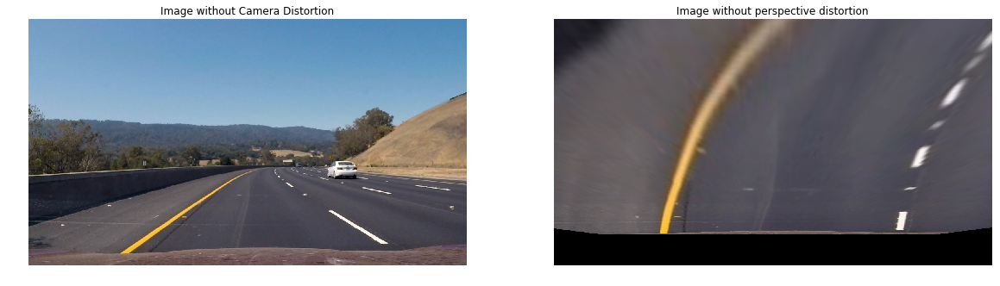

In [379]:

image_curved_lines_1 = cv2.imread("../data/test_images/test3.jpg")
undist_road_img = undistort_img(image_curved_lines_1, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 
show_side_by_side(bgr2rgb(image_curved_lines_1),bgr2rgb(unwarped_curves), title1= "Image without Camera Distortion", title2 = "Image without perspective distortion",cmap=('jet','jet'))



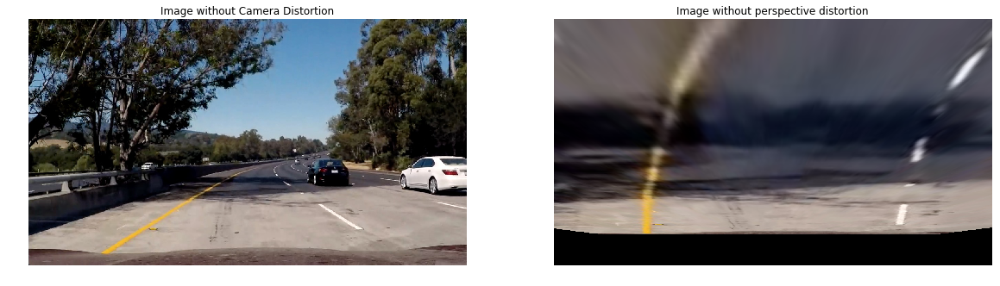

In [380]:
image_curved_lines_2 = cv2.imread("../data/test_images/test5.jpg")
undist_road_img = undistort_img(image_curved_lines_2, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 
show_side_by_side(bgr2rgb(image_curved_lines_2),bgr2rgb(unwarped_curves), title1= "Image without Camera Distortion", title2 = "Image without perspective distortion",cmap=('jet','jet'))


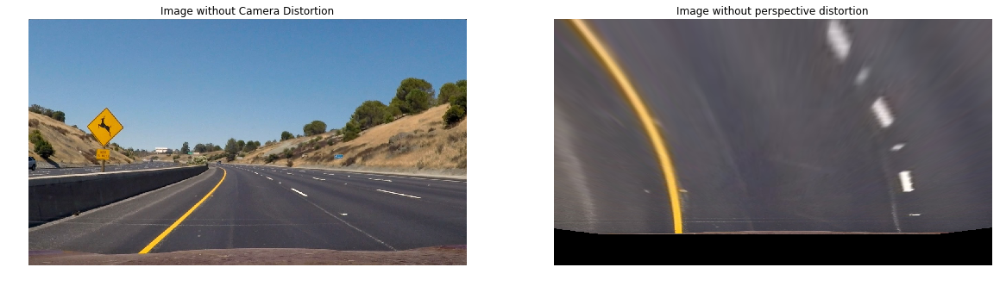

In [381]:
image_curved_lines_3 = cv2.imread("../data/test_images/test2.jpg")
undist_road_img = undistort_img(image_curved_lines_3, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 
show_side_by_side(bgr2rgb(image_curved_lines_3),bgr2rgb(unwarped_curves), title1= "Image without Camera Distortion", title2 = "Image without perspective distortion",cmap=('jet','jet'))


### Step 2: Use color transforms, gradients, etc., to create a thresholded binary image.
I tried several combinations of the  thresholding techniques in gradient space and different color spaces. 

* Gradient space (using Sobel filter to get gradeint) thresholding works when the surface of the road is free from shadows and there are no sudden changes in pavement.
* Color space thresholding was found more  effective in detecting the lane pixels. Colorspace thresholding was implemented in `color_threshold(img,colorspace = 'HLS',channel = 2,thresh=(0, 255))` function. 
* Detecting the two lane colors separately worked very well by choosing the right colorspace, the channel and the threshold. Particularly `b` channel of `Lab` space with a threshold of `(155, 200)` was effective in detecting the yellow lanes and `L` channel of `LUV` colorspace with a threshold of `(201,255)` was found effective in detecting the white lanes.
* A combined thresholding pipeline is implemented in `threshold_pipeline(img)`.

Yellow lines are well discovered by b channel of Lab. The white is totally lost.

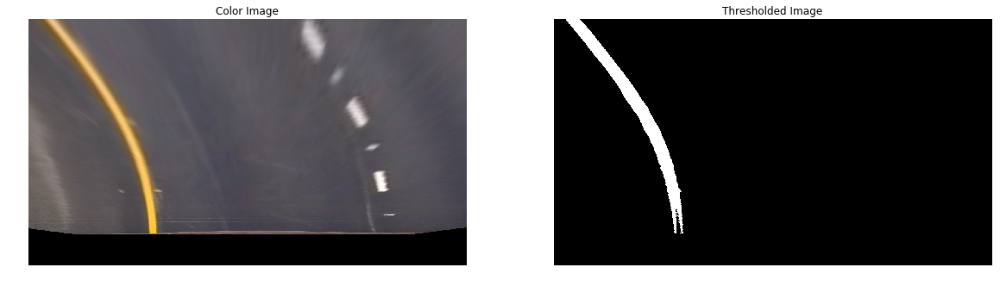

In [382]:
image_curved_lines_3 = cv2.imread("../data/test_images/test2.jpg")
undist_road_img = undistort_img(image_curved_lines_3, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 

thresholded_img = color_threshold(unwarped_curves,colorspace = 'Lab',channel = 2,thresh=(155, 200))
show_side_by_side(bgr2rgb(unwarped_curves),thresholded_img, title1= "Color Image", title2 = "Thresholded Image",cmap=('jet','gray'))


`L` channel of `LUV` colorspace works well in detecting white pixels. 

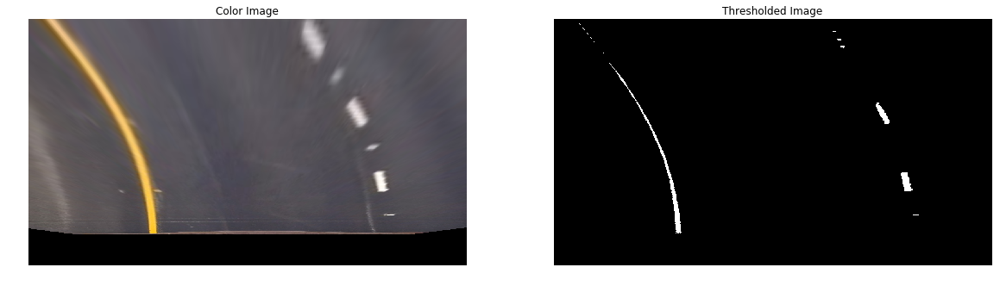

In [383]:
image_curved_lines_3 = cv2.imread("../data/test_images/test2.jpg")
undist_road_img = undistort_img(image_curved_lines_3, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 

thresholded_img = color_threshold(unwarped_curves,colorspace = 'LUV',channel = 0,thresh=(210, 255))
show_side_by_side(bgr2rgb(unwarped_curves),thresholded_img, title1= "Color Image", title2 = "Thresholded Image",cmap=('jet','gray'))


Trying out the harder cases for lane detection 

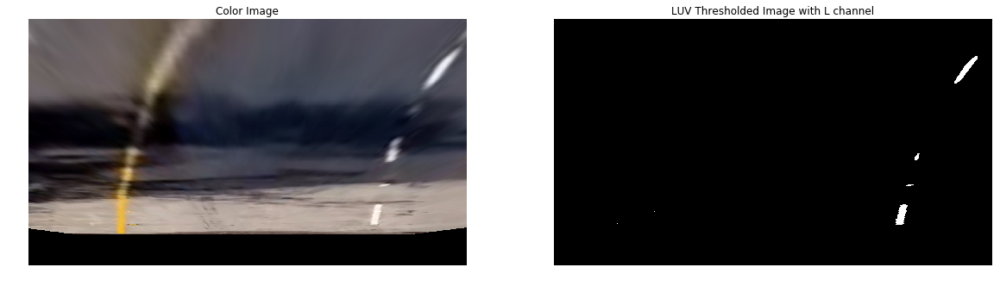

In [384]:
image_curved_lines_2 = cv2.imread("../data/test_images/test5.jpg")
undist_road_img = undistort_img(image_curved_lines_2, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 
thresholded_img = color_threshold(unwarped_curves,colorspace = 'LUV',channel = 0,thresh=(210, 255))
show_side_by_side(bgr2rgb(unwarped_curves),thresholded_img, title1= "Color Image", title2 = "LUV Thresholded Image with L channel",cmap=('jet','gray'))


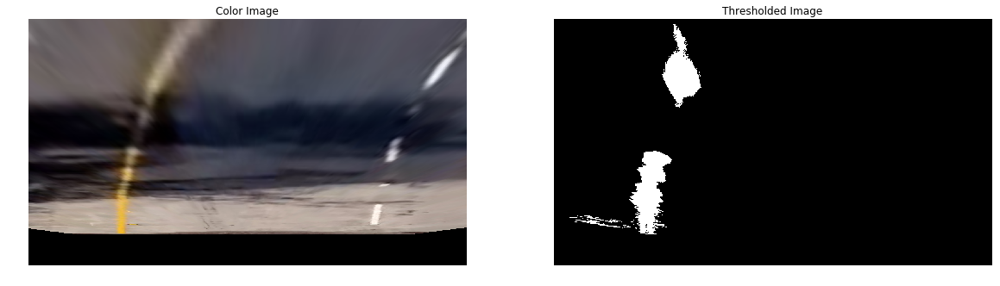

In [385]:
thresholded_img = color_threshold(unwarped_curves,colorspace = 'Lab',channel = 2,thresh=(140, 200))
show_side_by_side(bgr2rgb(unwarped_curves),thresholded_img, title1= "Color Image", title2 = "Thresholded Image",cmap=('jet','gray'))


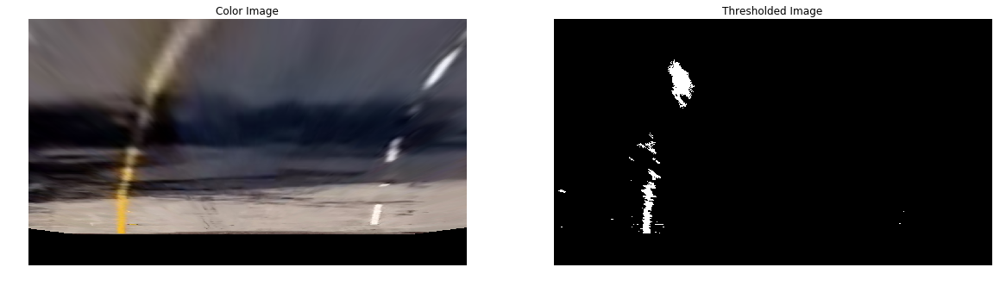

In [386]:
thresholded_img = color_threshold(unwarped_curves,colorspace = 'HSV',channel = 0,thresh=(20, 30))
show_side_by_side(bgr2rgb(unwarped_curves),thresholded_img, title1= "Color Image", title2 = "Thresholded Image",cmap=('jet','gray'))


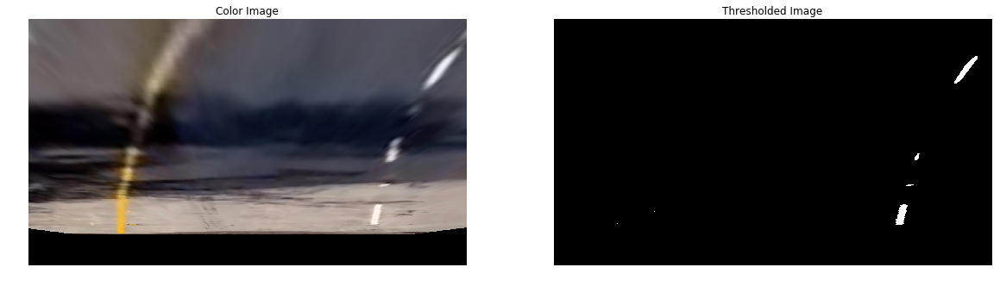

In [387]:
image_curved_lines_2 = cv2.imread("../data/test_images/test5.jpg")
undist_road_img = undistort_img(image_curved_lines_2, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 
thresholded_img = color_threshold(unwarped_curves,colorspace = 'LUV',channel = 0,thresh=(210, 255))
show_side_by_side(bgr2rgb(unwarped_curves),thresholded_img, title1= "Color Image", title2 = "Thresholded Image",cmap=('jet','gray'))


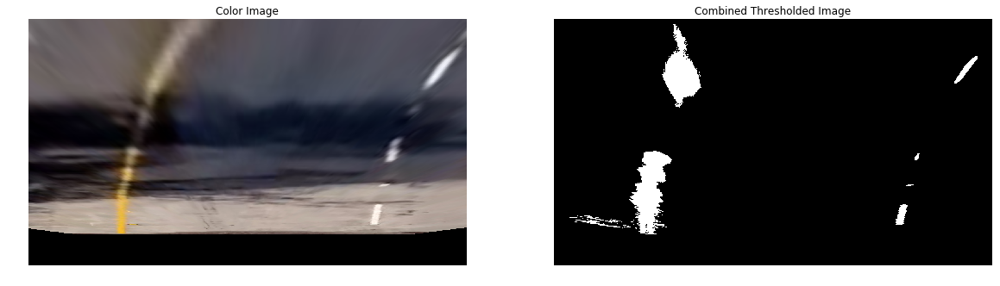

In [388]:
image_curved_lines_2 = cv2.imread("../data/test_images/test5.jpg")
undist_road_img = undistort_img(image_curved_lines_2, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 

combined_threshold = threshold_pipeline(unwarped_curves)
show_side_by_side(bgr2rgb(unwarped_curves),combined_threshold, title1= "Color Image", title2 = "Combined Thresholded Image",cmap=('jet','gray'))


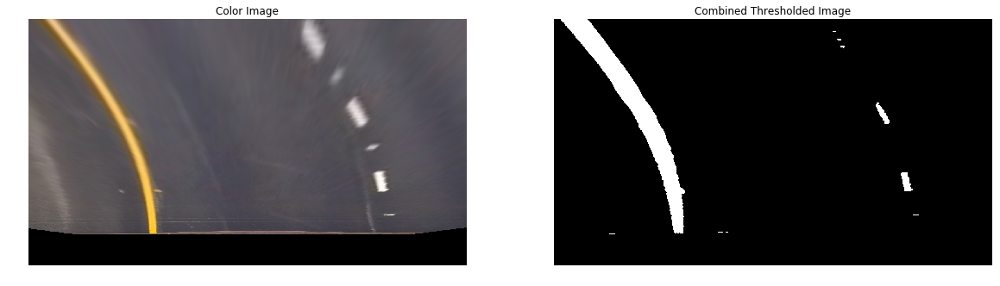

In [389]:
image_curved_lines_3 = cv2.imread("../data/test_images/test2.jpg")
undist_road_img = undistort_img(image_curved_lines_3, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 
combined_threshold = threshold_pipeline(unwarped_curves)
show_side_by_side(bgr2rgb(unwarped_curves),combined_threshold, title1= "Color Image", title2 = "Combined Thresholded Image",cmap=('jet','gray'))


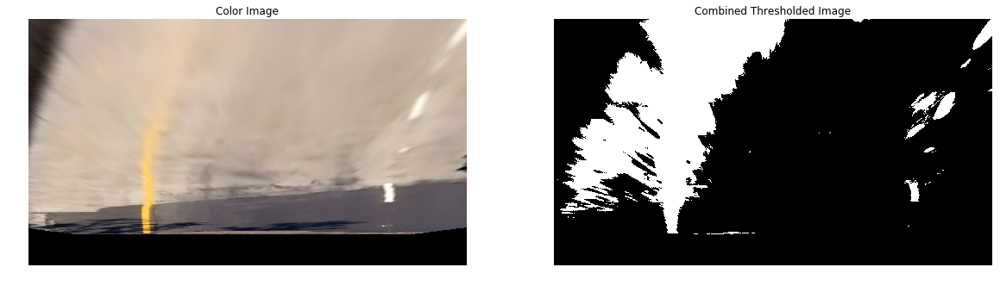

In [390]:
image_curved_lines_2 = cv2.imread("../data/test_images/test4.jpg")
undist_road_img = undistort_img(image_curved_lines_2, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 

combined_threshold = threshold_pipeline(unwarped_curves)
show_side_by_side(bgr2rgb(unwarped_curves),combined_threshold, title1= "Color Image", title2 = "Combined Thresholded Image",cmap=('jet','gray'))


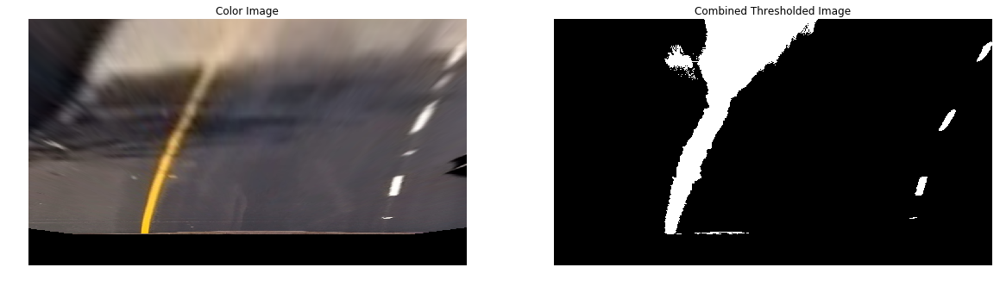

In [391]:
image_curved_lines_2 = cv2.imread("../data/test_images/test6.jpg")
undist_road_img = undistort_img(image_curved_lines_2, mtx,dist)
unwarped_curves = cv2.warpPerspective(undist_road_img,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 

combined_threshold = threshold_pipeline(unwarped_curves)
show_side_by_side(bgr2rgb(unwarped_curves),combined_threshold, title1= "Color Image", title2 = "Combined Thresholded Image",cmap=('jet','gray'))


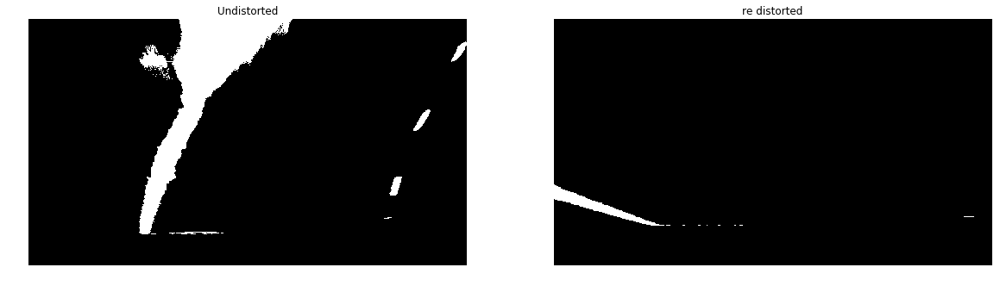

In [392]:
test = cv2.warpPerspective(combined_threshold,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) 
show_side_by_side(combined_threshold,test, title1= "Undistorted", title2 = "re distorted",cmap=('gray','gray'))


In [393]:
mat_inverse_perspective, status = cv2.findHomography(dst, src)

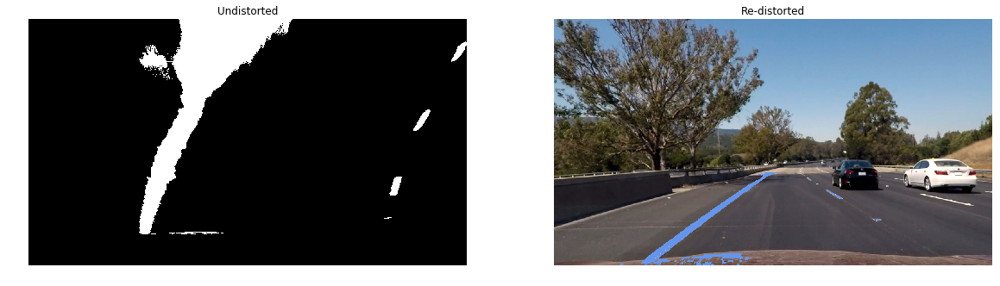

In [394]:

im_redistorted = cv2.warpPerspective(combined_threshold, mat_inverse_perspective, dsize=img_size)
undist_road_img[(im_redistorted ==1)] = (237,149,100)
show_side_by_side(combined_threshold,bgr2rgb(undist_road_img), title1= "Undistorted", title2 = "Re-distorted",cmap=('gray','gray'))


Below is the result of thresholding the images using the `threshold_pipeline` function.

In [395]:
unwarped_images = [cv2.warpPerspective(image,mat_perspective,dsize=img_size,flags=cv2.INTER_LINEAR) for image in  undistorted_images]
thresholded_unwarped_images = [threshold_pipeline(image) for image in unwarped_images]

#thresholded_unwarped_images_rgb = [bgr2rgb(image) for image in thresholded_unwarped_images]


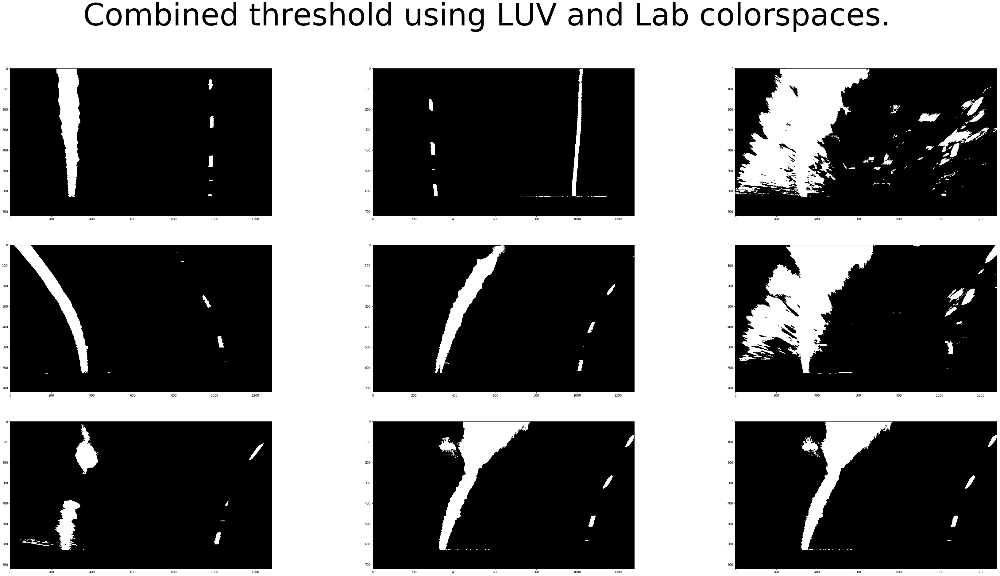

In [396]:

show_images(thresholded_unwarped_images, title ="Combined threshold using LUV and Lab colorspaces.")

### Detect lane pixels and fit to find the lane boundary

The position of the left and right lanes can be determined by finding the lane centers and then following the lane centers using a sliding window technique. 

A histogram of the pixel counts shows peaks near the lane locations as shown below. 

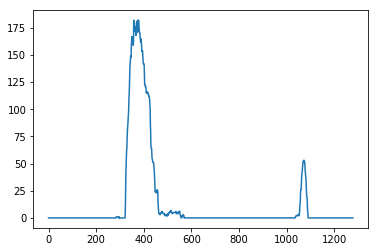

In [397]:
histogram = np.sum(combined_threshold[combined_threshold.shape[0]//2:,:], axis=0)
plt.plot(histogram)

In [398]:
combined_threshold.shape[0]//2

360

In [399]:
out_img = np.dstack((combined_threshold, combined_threshold, combined_threshold))*255
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

After detecting the peaks, we look for pixels around the center within a given window. This pixels are then used to fit a polynomial using the `numpy` function `polyfit` as implemented in the code below.  

In [400]:
binary_warped = np.copy(combined_threshold)

nwindows = 9
window_height = np.int(binary_warped.shape[0]/nwindows)
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])

leftx_current = leftx_base
rightx_current = rightx_base

margin = 100
minpix = 50
left_lane_inds = []
right_lane_inds = []



# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
    (0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
    (0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
    (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
    (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

Figure below shows a vislualization of the detected left and right lane pixels as shown in red and blue respectively, and the second degree fitted polynomial for each lane in yellow. 

(720, 0)

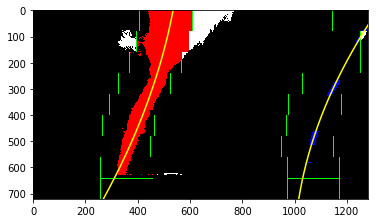

In [401]:
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

### Determine the curvature of the lane and vehicle position with respect to center. 

The radius of curvature `R` is computed using `R = ((1+(2Ay+B)^2)^(3/2))/2A` where `f(y) = Ay^2 + By + C` is the equation of the second degree polynomial as implemented below.

In [402]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)

# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')


## Find the offset of the car 
left_lane_x = left_fit[0]*y_eval**2 + left_fit[1]*y_eval + left_fit[2]
right_lane_x= right_fit[0]*y_eval**2 + right_fit[1]*y_eval + right_fit[2]
lane_center_x = (left_lane_x+right_lane_x)/2

vehicle_offset = (binary_warped.shape[1]/2-lane_center_x)*xm_per_pix

print('Vehicle Offset from Lane Center', vehicle_offset, 'm')




667.4718109227175 m 458.3094313375668 m
Vehicle Offset from Lane Center -0.014913007985238957 m


In [403]:
y_eval = np.max(ploty)
left_radius_of_curvature = get_radius_of_curvatrure(y_eval,left_fitx,ploty)

In [404]:
left_radius_of_curvature

667.4718109227175

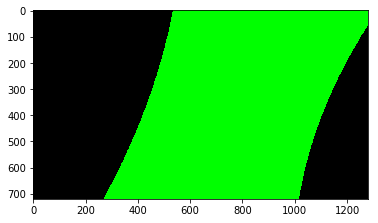

In [405]:
warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))
op = cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
fig = plt.imshow(op)
plt.show()

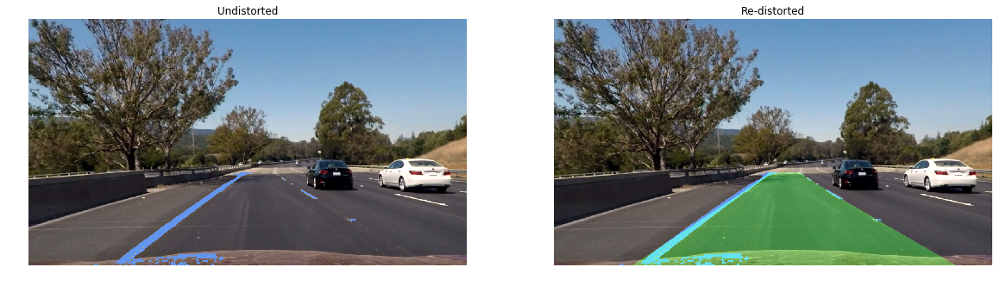

In [406]:
im_redistorted = cv2.warpPerspective(op, mat_inverse_perspective, dsize=img_size)
#undist_road_img[(im_redistorted ==1)] = (237,149,100)
result = cv2.addWeighted(undist_road_img, 1, im_redistorted, 0.3, 0)

show_side_by_side(bgr2rgb(undist_road_img),bgr2rgb(result), title1= "Undistorted", title2 = "Re-distorted",cmap=('gray','gray'))


In [407]:
undist_road_img.shape

(720, 1280, 3)

In [408]:
camera_matrix = mtx
dist_coeffs = dist
perspective_transform_matrix = mat_perspective
inverse_perspective_transform_matrix = mat_inverse_perspective
lane_poly = np.zeros_like(op)

### Warp the detected lane boundaries back onto the original image.
* The bird's eye view image is mapped back onto the original image by computing the inverse tranformation matrix from the `dst` points to the `src` points using `findHomography(dst, src)`
* The pipeline for processing the image is implemented in `process_image(img)`

In [409]:
#def process_image(img, camera_matrix,dist_coeffs, perspective_transform_matrix, inverse_perspective_transform_matrix):
def process_image(img):
    img_bgr = cv2.cvtColor(img,cv2.COLOR_RGB2BGR)
    undist_road_img = undistort_img(img_bgr, camera_matrix,dist_coeffs)
    image_size = (undist_road_img.shape[1], undist_road_img.shape[0])
    perspective_unwarped_img = cv2.warpPerspective(undist_road_img,perspective_transform_matrix,dsize=image_size,flags=cv2.INTER_LINEAR) 

    binary_warped = threshold_pipeline(perspective_unwarped_img)
    
    nwindows = 9
    window_height = np.int(binary_warped.shape[0]/nwindows)
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    leftx_current = leftx_base
    rightx_current = rightx_base

    margin = 100
    minpix = 50
    left_lane_inds = []
    right_lane_inds = []



    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # plot filled polygon     
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    color_warp = cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    ## draw lane lines 
    thickness = 10
    pts_left_lane_left = np.array([np.transpose(np.vstack([left_fitx-thickness, ploty]))])
    pts_left_lane_right = np.array([np.flipud(np.transpose(np.vstack([left_fitx+thickness, ploty])))])
    pts = np.hstack((pts_left_lane_left, pts_left_lane_right))
    color_warp = cv2.fillPoly(color_warp, np.int_([pts]), (0,0,255))
    
    pts_right_lane_left = np.array([np.transpose(np.vstack([right_fitx-thickness, ploty]))])
    pts_right_lane_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx+thickness, ploty])))])
    pts = np.hstack((pts_right_lane_left, pts_right_lane_right))
    op = cv2.fillPoly(color_warp, np.int_([pts]), (255,0,0))
    
    
    
    img_redistorted = cv2.warpPerspective(op, inverse_perspective_transform_matrix, dsize=img_size)
    #undist_road_img[(im_redistorted ==1)] = (237,149,100)
    result = cv2.addWeighted(undist_road_img, 1, img_redistorted, 0.5, 0)
    result_rgb = cv2.cvtColor(result,cv2.COLOR_BGR2RGB)
    
    y_eval = np.max(ploty)
    left_radius_of_curvature = get_radius_of_curvatrure(y_eval,left_fitx,ploty)
    right_radius_of_curvature = get_radius_of_curvatrure(y_eval,right_fitx,ploty)
    radius_of_curvature = (left_radius_of_curvature+right_radius_of_curvature)/2
    
    radius_str = "radius of curvature: "+'{:04.2f}'.format(radius_of_curvature) +'m'
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result_rgb,radius_str,(10,100), font, 1,(255,255,255),2,cv2.LINE_AA)
    
    ## calculate offset 
    left_lane_x = left_fit[0]*y_eval**2 + left_fit[1]*y_eval + left_fit[2]
    right_lane_x= right_fit[0]*y_eval**2 + right_fit[1]*y_eval + right_fit[2]
    lane_center_x = (left_lane_x+right_lane_x)/2

    vehicle_offset = (binary_warped.shape[1]/2-lane_center_x)*xm_per_pix
    direction = ''
    if vehicle_offset > 0:
        direction = 'right'
    elif vehicle_offset < 0:
        direction = 'left'
    abs_vehicle_offset = abs(vehicle_offset)

    offset_str='Vehicle Offset: '+'{:04.3f}'.format(abs_vehicle_offset)+'m '+ direction + " of center"
    cv2.putText(result_rgb,offset_str,(10,140), font, 1,(255,255,255),2,cv2.LINE_AA)
    

    return result_rgb

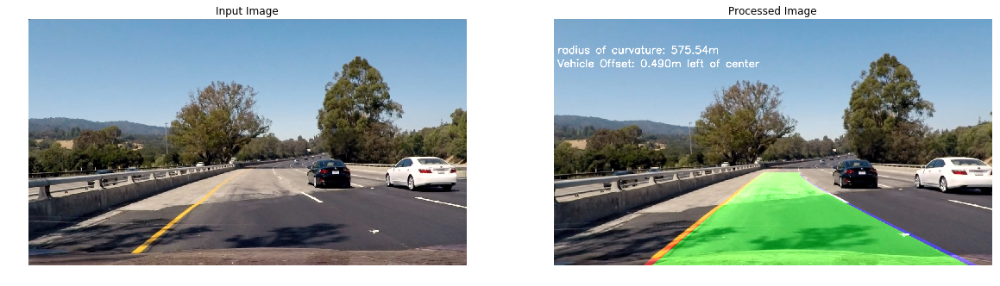

In [410]:


input_img = mpimg.imread("../data/test_images/test4.jpg")
result_img = process_image(input_img)
show_side_by_side(input_img,result_img, title1= "Input Image", title2 = "Processed Image",cmap=('gray','gray'))


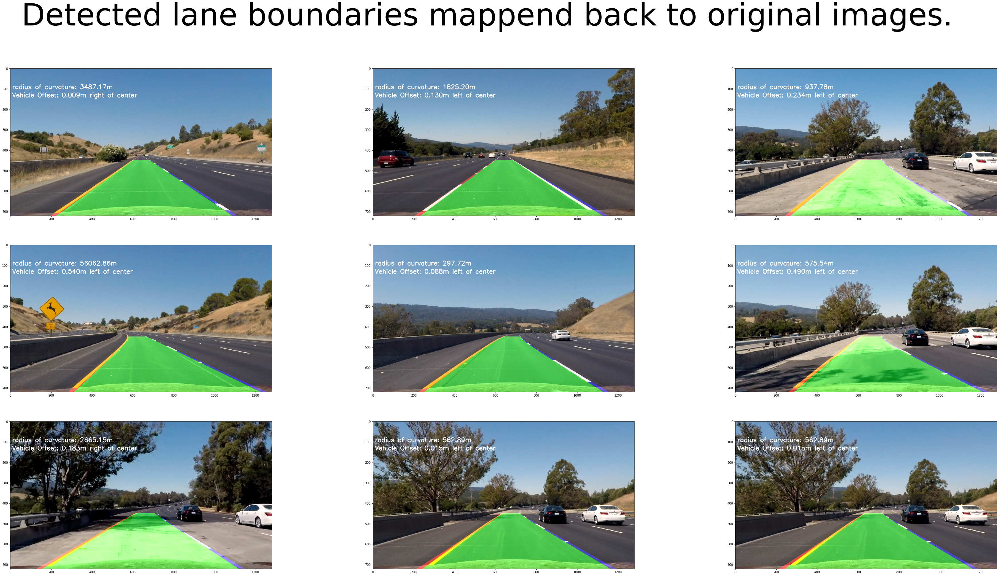

In [411]:
result_images =[process_image(image) for image in test_images_rgb]
show_images(result_images, title = 'Detected lane boundaries mappend back to original images.')

### Video processing 

The final video is included with the project files. 

In [412]:
# Video processing 

clip_output_path = '../reports/result.mp4'
clip = VideoFileClip('../data/project_video.mp4')#.subclip(0,5)
new_clip = clip.fl_image(process_image)
new_clip.write_videofile(clip_output_path, audio=False)

[MoviePy] >>>> Building video ../reports/result.mp4
[MoviePy] Writing video ../reports/result.mp4


100%|█████████▉| 1260/1261 [01:47<00:00, 11.78it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ../reports/result.mp4 



### Discussion: Problems encountered during implementation

* Camera Calibration: All the the 20 images supplied do not work when you try to detect corner points. This may be due the chessboard corners being cropped off. I used the images that did return corners.
* Gradient Space Thresholding: Thresholding using Sobel gradient did not work very well for me. I tried using the magnitude, the direction, Sobel x and Sobel y gradients. 
* Choosing the right colorspace,channel and  threshold values for lane detection required some experimenting. A better segmentation algorithm, perhaps something that uses a neural network could be used for lane detection.    
